In [1]:
"""
    Importeer libraries
    """
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import pandas as pd
from scipy.spatial import cKDTree
from math import sqrt, ceil
from scipy.stats import linregress    
import libraries as lib
import math 
    

In [2]:
"""
    Laadt motordriver-data in, selecteert een subset van rijen, corrigeert GPS-coördinaten
    en voegt snelheden in m/s toe.

    Parameters:
    directory (str): Pad naar de directory met het databestand.
    file_motordriver (str): Naam van het motordriver-databestand.
    start_row (int): Startindex van de te selecteren rijen (inclusief).
    end_row (int): Eindindex van de te selecteren rijen (inclusief).

    Returns:
    pd.DataFrame: Geprocessed DataFrame met geselecteerde rijen, gecorrigeerde GPS-coördinaten
                  en snelheden in m/s.
    """
import libraries as lib

directory2 = "/Users\qvled\OneDrive - HvA\Logfiles\H2A/2022/20221027T153630 46m11s 2.264km P2 Arena/"
directory = "/Users\qvled\OneDrive - HvA\Logfiles\H2A/2023/Nogaro/20230525_h2a_poging1/0002/"
# file_motordriver = "3.csv"
file_motordriver = "3_DCMD_H2A_03_04.csv"
# start_row = 223257
# end_row = 479444

start_row = 0
end_row = -1

filtered_motordriver = lib.verwerk_motordriver_data(directory2, file_motordriver, start_row, end_row)
filtered_motordriver

,Datalogger port,"Dataloggertijd, in s",Format header (>03|04),Tijd sinds laatste herstart motordriver (s),Spanning over de motor (V),Stroom door de motor (A),Vermogen geleverd aan de motor (W),Energie geleverd aan de motor sinds reset (J),Spanning aan de ingang van motordriver (V),Stroom door de ingang van motordriver (A),...,"Toestand cruise control2-knop (aan=1, uit=0)",Tijdstip laatste verandering cruise control2-knop,"GPS longitude, in graden","GPS latitude, in graden",GPS direction,"GPS speed, in km/h","GPS time, in seconden sinds het begin van de huidige GPS-week",Checksum,"Wielsnelheid, in m/s","GPS speed, in m/s"
0,3,99.1790,03|04,0.0060,2.045,0.010,0.2,0,2.322,0.012,...,0,0.000,NaN,NaN,NaN,NaN,NaN,NaN,1.085278,NaN
1,3,99.1846,03|04,0.0116,3.702,0.017,0.3,0,4.202,0.017,...,0,0.000,NaN,NaN,NaN,NaN,NaN,NaN,0.601389,NaN
2,3,99.1902,03|04,0.0172,5.197,0.025,0.5,0,5.896,0.017,...,0,0.000,4.933295,52.313858,NaN,NaN,NaN,NaN,0.429722,NaN
3,3,99.1967,03|04,0.0236,6.727,0.031,0.6,0,7.630,0.024,...,0,0.000,4.933295,52.313858,175.0,2.2,133659.0,NaN,0.333056,0.611111
4,3,99.2040,03|04,0.0310,8.288,0.038,0.7,0,9.396,0.026,...,0,0.000,4.933295,52.313858,175.0,2.2,133659.0,NaN,0.000000,0.611111
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
118530,3,2271.1957,03|04,945.9646,0.044,0.230,0.0,48453,8.323,0.088,...,0,925.735,4.933190,52.313925,164.2,0.0,141309.0,NaN,0.000000,0.000000
118531,3,2271.2039,03|04,945.9728,0.044,0.236,0.0,48453,8.018,0.092,...,0,925.735,4.933190,52.313925,164.2,0.0,141309.0,NaN,0.000000,0.000000
118532,3,2271.2121,03|04,945.9810,0.044,0.245,0.0,48453,7.704,0.098,...,0,925.735,4.933190,52.313925,164.2,0.0,141309.0,NaN,0.000000,0.000000
118533,3,2271.2202,03|04,945.9892,0.044,0.253,0.0,48453,7.379,0.100,...,0,925.735,4.933190,52.313925,164.2,0.0,141309.0,NaN,0.000000,0.000000


In [3]:
import pandas as pd
import numpy as np

def bereken_energie_en_rendement(df):
    massa = 90

    # Bereken kinetische energie op basis van GPS snelheid
    df['Kinetische energie (GPS) (J)'] = 0.5 * massa * df['GPS speed, in m/s'] ** 2
    df['Delta energie geleverd'] = df['Energie geleverd aan de motor sinds reset (J)'].diff()

    # Maak een kolom die aangeeft waar GPS-snelheid verandert
    df['GPS_snelheid_veranderd'] = df['GPS speed, in m/s'].ne(df['GPS speed, in m/s'].shift())

    # Maak een nieuwe kolom om delta energie alleen bij GPS-wijzigingen te berekenen
    delta_energie_tussen_punten = []
    last_energy = df.loc[df.index[0], 'Energie geleverd aan de motor sinds reset (J)']

    for index, changed in enumerate(df['GPS_snelheid_veranderd']):
        if changed:  # Als GPS-snelheid verandert, sla het verschil op
            current_energy = df.loc[df.index[index], 'Energie geleverd aan de motor sinds reset (J)']
            delta_energie_tussen_punten.append(current_energy - last_energy)
            last_energy = current_energy
        else:
            delta_energie_tussen_punten.append(np.nan)

    df['Delta energie geleverd (bij GPS verandering)'] = pd.Series(delta_energie_tussen_punten, index=df.index)

    # Eventueel: NaN's invullen met 0 voor duidelijkheid
    df['Delta energie geleverd (bij GPS verandering)'] = df['Delta energie geleverd (bij GPS verandering)'].fillna(0)

    # Bereken Delta kinetische energie bij GPS-veranderingen
    df['Delta kinetische energie (GPS)'] = df['Kinetische energie (GPS) (J)'].diff()

    # Bereken rendement voor rijen waar Delta energie geleverd niet gelijk is aan 0
    df['Rendement (bij GPS verandering) (%)'] = np.where(
        df['Delta energie geleverd (bij GPS verandering)'] != 0,
        (df['Delta kinetische energie (GPS)'] / df['Delta energie geleverd (bij GPS verandering)']) * 100,
        np.nan  # Geen rendement als delta energie 0 is
    )

    # Retourneer het dataframe
    return df

# Pas de functie toe op je dataset
df_r = bereken_energie_en_rendement(filtered_motordriver)

df_r


,Datalogger port,"Dataloggertijd, in s",Format header (>03|04),Tijd sinds laatste herstart motordriver (s),Spanning over de motor (V),Stroom door de motor (A),Vermogen geleverd aan de motor (W),Energie geleverd aan de motor sinds reset (J),Spanning aan de ingang van motordriver (V),Stroom door de ingang van motordriver (A),...,"GPS time, in seconden sinds het begin van de huidige GPS-week",Checksum,"Wielsnelheid, in m/s","GPS speed, in m/s",Kinetische energie (GPS) (J),Delta energie geleverd,GPS_snelheid_veranderd,Delta energie geleverd (bij GPS verandering),Delta kinetische energie (GPS),Rendement (bij GPS verandering) (%)
0,3,99.1790,03|04,0.0060,2.045,0.010,0.2,0,2.322,0.012,...,NaN,NaN,1.085278,NaN,NaN,NaN,True,0.0,NaN,NaN
1,3,99.1846,03|04,0.0116,3.702,0.017,0.3,0,4.202,0.017,...,NaN,NaN,0.601389,NaN,NaN,0.0,True,0.0,NaN,NaN
2,3,99.1902,03|04,0.0172,5.197,0.025,0.5,0,5.896,0.017,...,NaN,NaN,0.429722,NaN,NaN,0.0,True,0.0,NaN,NaN
3,3,99.1967,03|04,0.0236,6.727,0.031,0.6,0,7.630,0.024,...,133659.0,NaN,0.333056,0.611111,16.805556,0.0,True,0.0,NaN,NaN
4,3,99.2040,03|04,0.0310,8.288,0.038,0.7,0,9.396,0.026,...,133659.0,NaN,0.000000,0.611111,16.805556,0.0,False,0.0,0.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
118530,3,2271.1957,03|04,945.9646,0.044,0.230,0.0,48453,8.323,0.088,...,141309.0,NaN,0.000000,0.000000,0.000000,0.0,False,0.0,0.0,NaN
118531,3,2271.2039,03|04,945.9728,0.044,0.236,0.0,48453,8.018,0.092,...,141309.0,NaN,0.000000,0.000000,0.000000,0.0,False,0.0,0.0,NaN
118532,3,2271.2121,03|04,945.9810,0.044,0.245,0.0,48453,7.704,0.098,...,141309.0,NaN,0.000000,0.000000,0.000000,0.0,False,0.0,0.0,NaN
118533,3,2271.2202,03|04,945.9892,0.044,0.253,0.0,48453,7.379,0.100,...,141309.0,NaN,0.000000,0.000000,0.000000,0.0,False,0.0,0.0,NaN


In [4]:
meetstuk_recht = filtered_motordriver.loc[13121:15000].copy()
meetstuk_recht2 = filtered_motordriver.loc[25000:36000].copy()
meetstuk_recht3 = filtered_motordriver.loc[38400:50000].copy()
# meetstuk_recht4 = filtered_motordriver.loc[38400:51000].copy()
meetstuk_recht5 = filtered_motordriver.loc[111000:112803].copy()

# Pas de functie toe
df_r1 = bereken_energie_en_rendement(meetstuk_recht)
df_r2 = bereken_energie_en_rendement(meetstuk_recht2)
df_r3 = bereken_energie_en_rendement(meetstuk_recht3)
# df_r4 = bereken_energie_en_rendement(meetstuk_recht4)
df_r5 = bereken_energie_en_rendement(meetstuk_recht5)



In [6]:
import plotly.express as px
import pandas as pd

# Maak een dataframe met coördinaten


df = pd.DataFrame(df_r)
# Voeg de rij-index expliciet toe als kolom
df = df.reset_index()
# Maak een scattermapbox met Plotly
fig = px.scatter_mapbox(
    df, 
    lat="GPS latitude, in graden", 
    lon="GPS longitude, in graden", 
    zoom=15,  # Zoomniveau van de kaart
    height=800,
    hover_data={
        'index': True,  # Rij-index
        'Energie geleverd aan de motor sinds reset (J)': True,  # Geleverde energie
    },
    title="Weergave van coördinaten"
)

# Stel de stijl van de kaart in (bijv. open-street-map)
fig.update_layout(mapbox_style="open-street-map")

# Toon de kaart
fig.show()

In [26]:
import plotly.express as px
import pandas as pd

# Voeg een kolom toe die de dataset identificeert
df_r1['Cluster'] = 'Cluster 1'
df_r2['Cluster'] = 'Heenweg'
df_r3['Cluster'] = 'Terugweg'
# df_r4['Cluster'] = 'Terugweg'
df_r5['Cluster'] = 'Cluster 5'

# Combineer alle dataframes
combined_df = pd.concat([df_r1, df_r2, df_r3, df_r4, df_r5], ignore_index=False)

# Voeg de rij-index expliciet toe als kolom
combined_df = combined_df.reset_index()

# Maak de Plotly scatterplot
fig = px.scatter(
    combined_df, 
    x='GPS speed, in km/h', 
    y='Rendement (bij GPS verandering) (%)', 
    color='Cluster',
    hover_data={
        'index': True,  # Rij-index
        'Energie geleverd aan de motor sinds reset (J)': True,  # Geleverde energie
        'GPS direction': True,  # GPS richting
        'Cluster': False  # Verberg clusternaam bij hover
    },
    title='Rendement motor waterstofauto tegen GPS snelheid',
    labels={'GPS speed, in km/h': 'GPS Snelheid (km/h)', 
            'Rendement (bij GPS verandering) (%)': 'Rendement (%)'}
)

# Beperk de y-as
fig.update_yaxes(range=[0, 110])

# Toon de interactieve plot
fig.show()


In [27]:
# Maak de Plotly scatterplot
fig = px.scatter_mapbox(
    combined_df, 
    lat="GPS latitude, in graden", 
    lon="GPS longitude, in graden",
    color='Cluster',
    zoom=15,  # Zoomniveau van de kaart
    height=800,
    hover_data={
        'index': True,  # Rij-index
        'Energie geleverd aan de motor sinds reset (J)': True,  # Geleverde energie
    },
    title="Weergave van coördinaten"
)

# Stel de stijl van de kaart in (bijv. open-street-map)
fig.update_layout(mapbox_style="open-street-map")

# Toon de kaart
fig.show()

In [ ]:
"""
    Maakt een interactieve scatterplot van GPS-coördinaten met kleuren die afhankelijk zijn van het geleverde vermogen.
    Optioneel kunnen aangepaste punten worden toegevoegd.

    Parameters:
    df (pd.DataFrame): DataFrame met de kolommen 'GPS longitude, in graden', 'GPS latitude, in graden' en 'Vermogen geleverd aan de motor (W)'.
    custom_points (list of tuples, optional): Lijst met tuples met (longitude, latitude) coördinaten voor extra punten. Standaard is None.

    Returns:
    Geel = geen vermogen
    Blauw = Wel vermogen
    Rood = Zelf ingevoerde punten
    """
custom_points = []
# Aanroepen van de functie met aangepaste punten
lib.plot_gps_power(df_r, custom_points=custom_points)

# lib.plot_height_profile(df_r1['GPS latitude, in graden'], df_r1['GPS longitude, in graden'], df_r1['GPS speed, in km/h'])

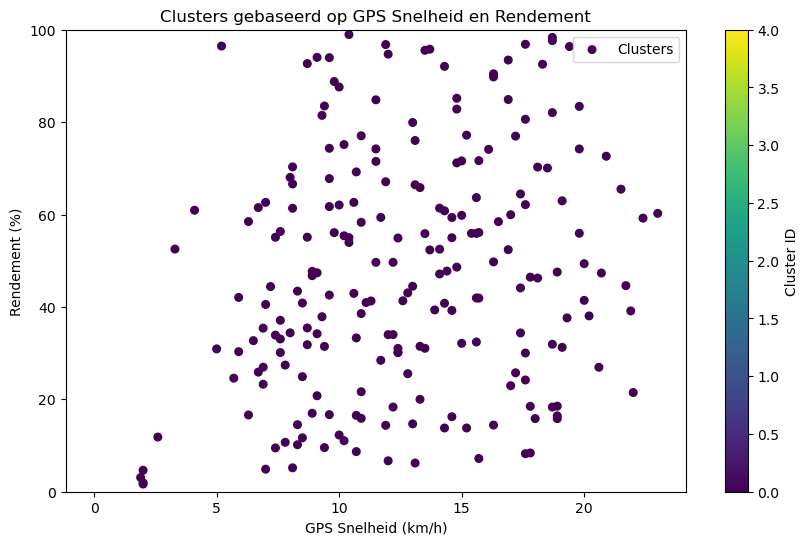

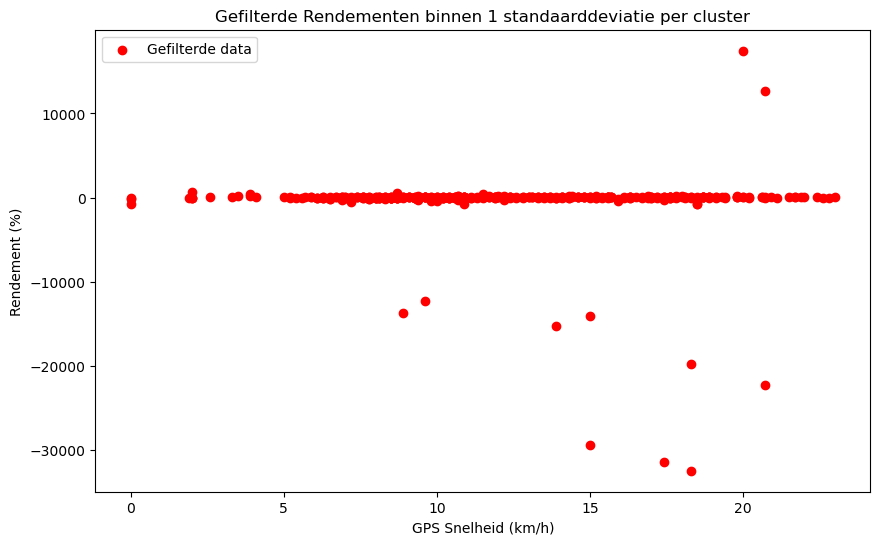

     Datalogger port  Dataloggertijd, in s Format header (>03|04)  \
0                  3              107.9192                  03|04   
1                  3              114.0045                  03|04   
2                  3              128.0106                  03|04   
3                  3             1390.0118                  03|04   
4                  3             1390.9519                  03|04   
..               ...                   ...                    ...   
388                3             1472.0965                  03|04   
389                3             1665.9055                  03|04   
390                3             1525.0289                  03|04   
391                3             1559.9373                  03|04   
392                3             1691.9244                  03|04   

     Tijd sinds laatste herstart motordriver (s)  Spanning over de motor (V)  \
0                                         8.7446                      23.735   
1          

In [137]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

def filter_clusters_kmeans(df, n_clusters=5):
    # Verwijder NaN-waarden
    df = df.dropna(subset=['GPS speed, in km/h', 'Rendement (bij GPS verandering) (%)']).reset_index(drop=True)

    # Selecteer alleen de kolommen voor clustering
    X = df[['GPS speed, in km/h', 'Rendement (bij GPS verandering) (%)']]

    # Pas K-means clustering toe
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    df['Cluster'] = kmeans.fit_predict(X)

    # Lijst om gefilterde data op te slaan
    filtered_rows = []

    # Filter per cluster
    for cluster_id in range(n_clusters):
        cluster_data = df[df['Cluster'] == cluster_id]

        # Bereken het gemiddelde en standaarddeviatie van rendement
        mean_rendement = cluster_data['Rendement (bij GPS verandering) (%)'].mean()
        std_rendement = cluster_data['Rendement (bij GPS verandering) (%)'].std()

        # Bepaal grenzen
        lower_bound = mean_rendement - std_rendement
        upper_bound = mean_rendement + std_rendement

        # Filter punten binnen het bereik
        filtered_cluster = cluster_data[
            (cluster_data['Rendement (bij GPS verandering) (%)'] >= lower_bound) &
            (cluster_data['Rendement (bij GPS verandering) (%)'] <= upper_bound)
        ]

        filtered_rows.append(filtered_cluster)

    # Combineer gefilterde clusters
    filtered_df = pd.concat(filtered_rows).reset_index(drop=True)

    return filtered_df, df

# Pas de functie toe op je dataframe
filtered_df, df_with_clusters = filter_clusters_kmeans(df_r, n_clusters=5)

# Plot de originele clusters
plt.figure(figsize=(10, 6))
plt.ylim(0, 100)
plt.scatter(df_with_clusters['GPS speed, in km/h'], 
            df_with_clusters['Rendement (bij GPS verandering) (%)'], 
            c=df_with_clusters['Cluster'], cmap='viridis', s=30, label='Clusters')
plt.colorbar(label='Cluster ID')
plt.xlabel('GPS Snelheid (km/h)')
plt.ylabel('Rendement (%)')
plt.title('Clusters gebaseerd op GPS Snelheid en Rendement')
plt.legend()
plt.show()

# Plot de gefilterde data
plt.figure(figsize=(10, 6))
plt.scatter(filtered_df['GPS speed, in km/h'], 
            filtered_df['Rendement (bij GPS verandering) (%)'], 
            color='r', label='Gefilterde data')
plt.xlabel('GPS Snelheid (km/h)')
plt.ylabel('Rendement (%)')
plt.title('Gefilterde Rendementen binnen 1 standaarddeviatie per cluster')
plt.legend()
plt.show()

# Toon de gefilterde data
print(filtered_df)


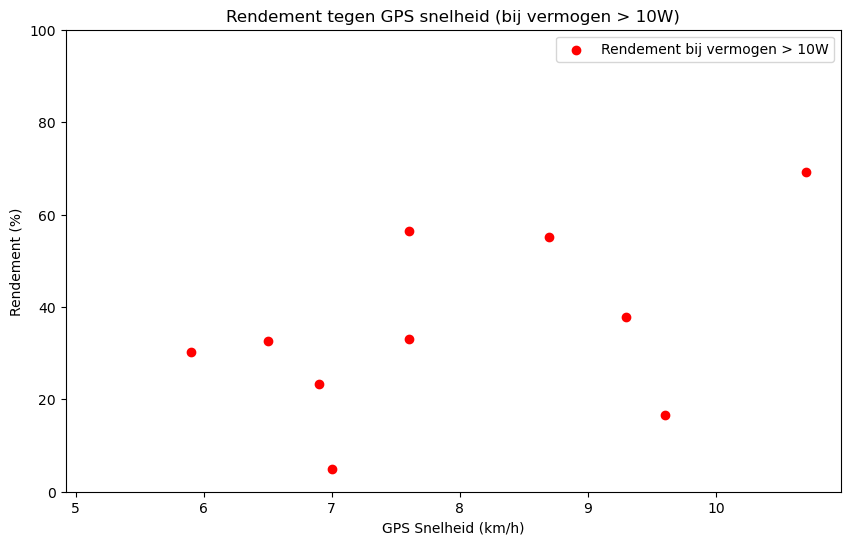

In [62]:
 import matplotlib.pyplot as plt

# Filter de data: alleen rijen waar vermogen > 10W
filtered_df = df_r[df_r['Vermogen geleverd aan de motor (W)'] > 30]

plt.figure(figsize=(10, 6))

# Maak de scatter plot met gefilterde data
plt.scatter(filtered_df['GPS speed, in km/h'], 
            filtered_df['Rendement (bij GPS verandering) (%)'], 
            label='Rendement bij vermogen > 10W', 
            color='r')

# Beperk de y-as
plt.ylim(0, 100)

# Labels en titel
plt.xlabel('GPS Snelheid (km/h)')
plt.ylabel('Rendement (%)')
plt.title('Rendement tegen GPS snelheid (bij vermogen > 10W)')
plt.legend()

# Toon de plot
plt.show()
